# Birmingham Purchase Cards Transactions <a class='tocSkip'>
-----
## Ana Isabel Rúa G.
## Msc.(c)Technology Information - Emphasis on Data Dcience <a class='tocSkip'>
#### https://github.com/anarua1203 

**Description:** With about 14  explanatory variables that describe (almost) all aspects of the corporate  purchase card transactions behavior for the Birmingham City Council, the idea for this paper is to use machine learning to explore and gain deeper knowledge from this data set.

** Where does this data comes from?:** Under the Code of Recommended Practice for Local Authorities on Data Transparency, councils are encouraged to publish all corporate purchase card transactions. 

Birmingham City Council has already publish details of all their relevant expenditure of more than £500 within Payments to Suppliers page, and will continue to do so. However, in the spirit of the Code, the Council started publishing all purchase card transactions, regardless of value, from the April 2014 card statement. 

Data: https://data.birmingham.gov.uk/dataset/purchase-card-transactions


**Problem tasks:** 
* (Clustering) Discovering profiles (whether the case) or unusual transactions (anomalies detection)
* (Forecasting) Try to guess future transactional behaviors. 

# Import Libraries

In [4]:
import pandas as pd
#pd.options.plotting.backend = "plotly"
import numpy as np
import os,glob
import pandas_profiling
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

## Work Paths

In [5]:
nbdir = '/Users/danielaacosta/Desktop/Birmingham-ml-project/ana.rua/notebooks'
data_path = '../data/raw/'

# Load Dataset

For this initial analysis I'll take into account a window for Purchase Card Transactios from January 2014 to January 2018. Is important to take into account that there are some months missing.

In [6]:
# I filter the *.xls files and make an append of each one of them to consolidate a single dataframe
df_append = pd.DataFrame()
for file in list(filter(lambda x: '.xls' in x, os.listdir(data_path))):
    df_append = df_append.append(pd.read_excel(data_path+'/'+file))
print(f'DataFrame has {df_append.shape[0]} rows and {df_append.shape[1]} columns')

DataFrame has 171123 rows and 19 columns


In [29]:
# Save appended df
#df_append.to_csv("../data/interim/raw_data_append.csv",sep = '|', index = False )

In [50]:
df_append = pd.read_csv("../data/interim/raw_data_append.csv",sep = '|')

/Users/danielaacosta/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (11,14,15,17,18) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


# Data Description

Data description is divided into several parts:

    1. Statistical information for numerical variables.
    2. Visual exploration for numerical variables.
    3. Visual exploration for categorical variables.

Each of the steps in this process is carried out below.

In [7]:
df_append.head(3)

,TRANS DATE,TRANS VAT DESC,ORIGINAL GROSS AMT,MERCHANT NAME,CARD NUMBER,TRANS CAC CODE 1,TRANS CAC DESC 1,TRANS CAC CODE 2,TRANS CAC DESC 2,TRANS CAC CODE 3,Directorate,ORIGINAL CUR,BILLING GROSS AMT,BILLING CUR CODE,Directorates,Directorate,TRANS TAX AMT,BILLING CUR CODE.1,Unnamed: 10
0,2015-05-06,VR,38.28,shell corrida 108,************0541,K020,Vehicle Fuel,RV12T,"Shakti Elders Dce, 73 Conybere St, B12",A00,Adult & Communities,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-05-14,VR,34.23,tex city sstn,************0541,K020,Vehicle Fuel,RV12T,"Shakti Elders Dce, 73 Conybere St, B12",A00,Adult & Communities,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2015-05-21,VR,42.61,tex city sstn,************0541,K020,Vehicle Fuel,RV12T,"Shakti Elders Dce, 73 Conybere St, B12",A00,Adult & Communities,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [51]:
## Now I'll take a look at some statistical features

df_filas,df_columnas = df_append.shape[0], df_append.shape[1]
print(f'Amount of Rows:{df_filas}, Amount of Columns: {df_columnas}')

Amount of Rows:171123, Amount of Columns: 19


An additional file is loaded with the description of the fields. This is done to facilitate the understanding of the variables when exploring, cleaning and selecting attributes.

In [52]:
description = pd.read_csv('../data/interim/ColumnDescription.csv',sep = ';')
description

,Column,Description
0,TRANS DATE,Transaction date
1,TRANS VAT DESC,Value Added Tax Description: VR: Standard rate...
2,ORIGINAL GROSS AMT,Original Gross Amount
3,ORIGINAL CUR,Original Currency
4,BILLING GROSS AMT,Billing Gross Amount
5,BILLING CUR CODE,Billing Currency Code
6,MERCHANT NAME,Merchant Name
7,CARD NUMBER,Identifier
8,BILLING CUR CODE,Billing Currency Code
9,TRANS CAC CODE 1,Transaction Company Authentication Code 1


Check the data type for each attribute, and shows the total number of fields for each type.

In [53]:
# List existing columns and its data type, it is transpose to facilitate visivility
df_dtype =  pd.DataFrame(df_append.dtypes).reset_index(level = 0)

# Rename columns to facilitate its processing
df_dtype.rename(columns={'index':'column',0:'type'},inplace = True)
df_dtype['type'].value_counts()

object     16
float64     3
Name: type, dtype: int64

It is found that from the 19 columns that comprise the dataframe, there are 15 that are categorical, 3 that are numeric (floats) and 1 datetime.

It should also be borne in mind that the column, *Card Number* showld be threated like Identifier, and column * BILLING CUR CODE* is duplicated.

## Statistical Information for numerical Values:

In [54]:
# For numeric fields it obtains the basic statistical information
df_desc_numeric = df_append.describe().T.reset_index(level=0).rename(columns={"index": "columna"})
df_desc_numeric

,columna,count,mean,std,min,25%,50%,75%,max
0,ORIGINAL GROSS AMT,171122.0,179.593039,2167.238406,-486980.09,12.86,40.8,93.6075,280102.23
1,BILLING GROSS AMT,54229.0,207.605785,2369.229937,-486980.09,13.18,43.0,108.0000,44433.55
2,TRANS TAX AMT,4598.0,34.268212,149.519355,-440.65,0.00,0.0,11.7800,4932.76


**Conclusions 1:** From this statistical analysis there are some preliminary conclusions that are listed below and that we will seek to corroborate with the visual analysis of the numerical variables.

* TRANS TAX AMT has most of the values in 0, since even the 75th percentile is 0 but the maximum value is much higher than that value.
* In principle outliers are not identified, but it is necessary to carry out other analyzes to corroborate this.
* A priori, the minimum values must represent returns in the payment

## Visual exploration for numerical values

For this exploration, we begin by exploring the target variable "Sale Price" in more detail, obviously due to its relevance for the excersise. For this, a review is made in first instance of the number of nulls, to later make the distribution graphs.

In [55]:
df_append['ORIGINAL GROSS AMT'].isnull().sum()

1

Because this is the objective variable, null values should not be imputed, and bearing in mind that there is a significant number of records, we proceed to eliminate those with this null value.

In [56]:
df_append.dropna(subset=['ORIGINAL GROSS AMT'], inplace=True)
print(f'DataFrame has {df_append.shape[0]} rows and {df_append.shape[1]} columns')


DataFrame has 171122 rows and 19 columns


In [57]:
#sns.displot(df_append['ORIGINAL GROSS AMT'])

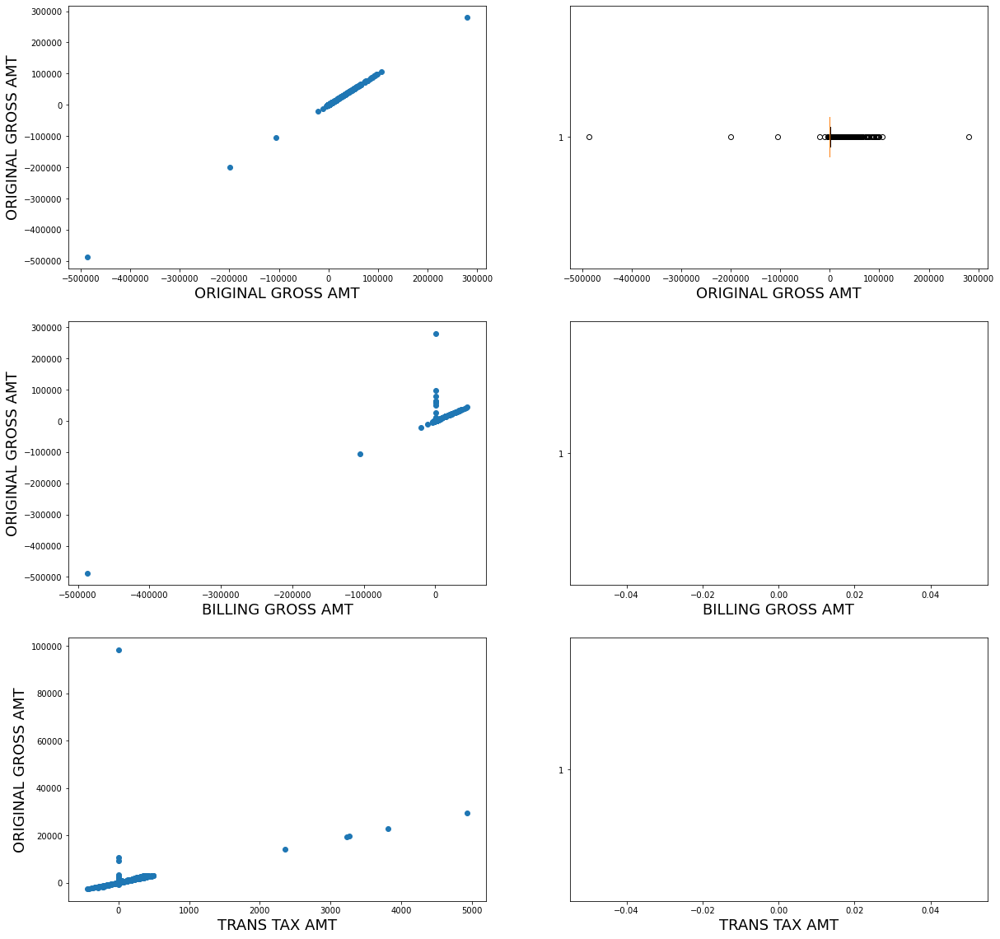

In [58]:
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(20, 20))

i=0    # Variable para almacenar la posición de la gráfica asociada
for index, fila in df_dtype.loc[(df_dtype["type"]=="int64") | (df_dtype["type"]=="float64")].iterrows():
    #Gráfica de dispersión entre la variable numérica y la variable objetivo "ORIGINAL GROSS AMT"
    axes[i, 0].scatter(df_append[fila["column"]], df_append["ORIGINAL GROSS AMT"])
    axes[i, 0].set_xlabel(fila["column"], fontsize=18)
    axes[i, 0].set_ylabel("ORIGINAL GROSS AMT", fontsize=18)

    #Boxplot de la variable numérica
    axes[i, 1].boxplot(df_append[fila["column"]],vert=False)
    axes[i, 1].set_xlabel(fila["column"], fontsize=18)
    
    # Incrementa el valor de i en cada iteración
    i=i+1

** Conclusions 2: ** When observing the different graphs of the numerical variables, some preliminary conclusions are found such as:
* There are outliers in multiple variables.
* Several of the box plots did not come out, possibly due to data problems (no cleanup).
* Apparently there are strong correlations between some variables with the target, such as TRANS TAX AMT, BILLING GROSS AMT.
* There are variables with values ​​concentrated in the initial value.

Bearing this in mind, before making a more in-depth analysis of the numerical variables, it is necessary to carry out the cleaning process and then the variable reduction process.

## Data Exploration for Cathegorical Values

In a similar way as was done with the numerical variables, for the categorical variables an iteration is made over the 43 categorical variables, to know their frequency and their relationship with the objective variable SalePrice by means of a swarmplot diagram.

In [60]:
fig, axes = plt.subplots(nrows=15, ncols=2, figsize=(20, 60))

i=0    # Variable para almacenar la posición de la gráfica asociada
for index, fila in df_dtype.loc[(df_dtype["type"]=="object")].iterrows():
    #Gráfica de frecuencia del campo
    valores = df_append[fila["column"]].value_counts()
    axes[i, 0].bar(valores.keys(), valores[:])
    axes[i, 0].set_xlabel(fila["column"])
    axes[i, 0].set_ylabel("Frecuencia")

    #Grafica las categorías frente a los valores de SalePrice
    sns.swarmplot(x=fila["column"], y="ORIGINAL GROSS AMT", data=df_append, ax=axes[i, 1])
    i=i+1

/Users/danielaacosta/opt/anaconda3/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 99.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/danielaacosta/opt/anaconda3/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 99.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/danielaacosta/opt/anaconda3/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 99.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/danielaacosta/opt/anaconda3/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 99.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/danielaacosta/opt

KeyboardInterrupt: 

# Data Cleaning

The data cleaning will be divided into several parts

    1. Missing (null) data.
    2. Atypical data (outliers).
    3. Duplicate data.

Each of the steps in this process is carried out below.

## Missing (null) data.

For this part of the cleaning, an analysis is first made of the amount of missing data that each of the variables has, in such a way that from now on the variables that have a high percentage of nulls are eliminated.

In [15]:
# Funcion para calcular el % de datos faltantes para cada columnas 
def missing_values_table(df_adf_append):
    # Total valores faltantes
    mis_val = df_adf_append.isnull().sum()
    
    # % valores faltantes 
    mis_val_percent = 100 * df_adf_append.isnull().sum() / len(df_adf_append)
    
    # Tabla para presentar datos
    mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
    
    # Renombrar columnas
    mis_val_table_ren_columns = mis_val_table.rename(
    columns = {0 : 'Missing ', 1 : '% of Total Values'})
    
    # Ordena la tabla de mayor faltantes a menor
    mis_val_table_ren_columns = mis_val_table_ren_columns[
        mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
    '% of Total Values', ascending=False).round(1)
    
    # Print resumen
    print ("Dataframe has " + str(df_adf_append.shape[1]) + " columnas.\n"      
        "of which " + str(mis_val_table_ren_columns.shape[0]) +
            " have missing values.")
    
    # Return the dataframe with missing information
    return mis_val_table_ren_columns

In [16]:
missing_values = missing_values_table(df_append)

Dataframe has 19 columnas.
of which 15 have missing values.


In [17]:
missing_values

,Missing,% of Total Values
Directorate,169060,98.8
Unnamed: 10,167163,97.7
TRANS TAX AMT,166524,97.3
BILLING CUR CODE.1,166524,97.3
Directorates,161283,94.3
ORIGINAL CUR,116893,68.3
BILLING GROSS AMT,116893,68.3
BILLING CUR CODE,87449,51.1
Directorate,16598,9.7
TRANS VAT DESC,9422,5.5


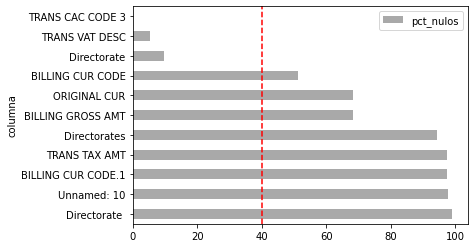

In [18]:
# Number of nulls in each of the columns, and% against the total number of records
umbral_nan = 40

df_nan = pd.DataFrame(df_append.isnull().sum()).reset_index(level=0)
df_nan.rename(columns={"index": "columna", 0: "num_nulos"}, inplace=True)
df_nan['pct_nulos'] = (df_nan['num_nulos']/df_filas)*100

df_nan.sort_values(by=['pct_nulos'], ascending=False).iloc[0:11,:].plot.barh(x='columna', 
                                                                             y='pct_nulos', color='darkgray')

plt.axvline(umbral_nan, color='red', linestyle='--');

It is found that there are several columns that have a significant amount of nulls (8 columns with more than 40% of null data), for which we proceed to eliminate them.

In [19]:
for index, fila in df_nan.loc[(df_nan["pct_nulos"]>umbral_nan)].iterrows():
    print(f'Column {fila["columna"]} removed')
    df_append.drop(columns=[fila["columna"]], axis=1, inplace=True)

df_filas, df_columnas = df_append.shape[0], df_append.shape[1]
print("")
print(f"New DataFrame size: {df_filas} rows, {df_columnas} columns")

Column ORIGINAL CUR removed
Column BILLING GROSS AMT removed
Column BILLING CUR CODE removed
Column Directorates removed
Column Directorate  removed
Column TRANS TAX AMT removed
Column BILLING CUR CODE.1 removed
Column Unnamed: 10 removed

New DataFrame size: 171122 rows, 11 columns


After eliminating these columns, the rows that have a significant number of nulls are reviewed and in a similar way as was done with the columns, they are eliminated.

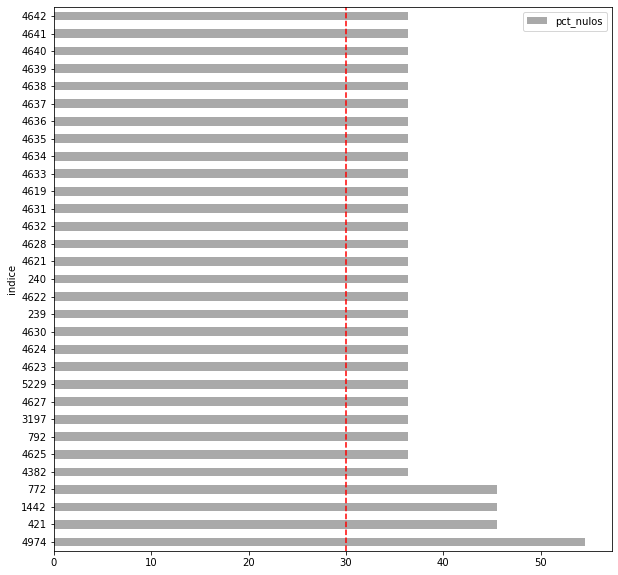

In [20]:
umbral_nan_r = 30

df_nan_r = pd.DataFrame(df_append.isnull().sum(axis=1)).reset_index(level=0)
df_nan_r.rename(columns={"index": "indice", 0: "num_nulos"}, inplace=True)
df_nan_r['pct_nulos'] = (df_nan_r['num_nulos']/df_columnas)*100

df_nan_r.sort_values(by=['pct_nulos'], ascending=False).iloc[0:31,:].plot.barh(x='indice', 
                                                                               y='pct_nulos', 
                                                                               color='darkgray',
                                                                               figsize=(10, 10))
plt.axvline(umbral_nan_r, color='red', linestyle='--');

Se encuentra que hay varias filas que tienen una cantidad importante de nulos , por lo cual se procede a eliminarlas.

In [21]:
df_append.dropna(axis="index", thresh=(df_columnas*(100-umbral_nan_r)/100), inplace=True)

df_filas, df_columnas = df_append.shape[0], df_append.shape[1]
print(f"New DataFrame size: {df_filas} rows, {df_columnas} columns")

New DataFrame size: 171072 rows, 11 columns


Subsequently, the number of nulls in the objective variable is reviewed for which, being few compared to the total number of registrations, they are eliminated.

In [22]:
#Primero validar los datos nulos en la variable objetivo, para los cuales, siendo porcos se define eliminar el tregistro
print(f"Number of nulls to eliminate in the target variable: {df_append['ORIGINAL GROSS AMT'].isnull().sum()}")

df_append.dropna(subset=["ORIGINAL GROSS AMT"], axis="index", inplace=True)

df_filas, df_columnas = df_append.shape[0], df_append.shape[1]
print("")
print(f"New dataframe size: {df_filas} filas, {df_columnas} columnas")

Number of nulls to eliminate in the target variable: 0

New dataframe size: 171072 filas, 11 columnas


Finally, a review is made of the number of nulls still existing in the entire dataframe, to later proceed to replace the nulls of each attribute by the median for the numerical ones and by the mode for the categorical ones.

In [23]:
print(f"Total null data in the entire dataframe: {df_append.isnull().sum(axis=1).sum(axis=0)}")

Total null data in the entire dataframe: 26744


In [24]:
missing_values = missing_values_table(df_append)

Dataframe has 11 columnas.
of which 7 have missing values.


In [25]:
missing_values

,Missing,% of Total Values
Directorate,16552,9.7
TRANS VAT DESC,9420,5.5
TRANS CAC CODE 3,240,0.1
TRANS CAC CODE 2,180,0.1
TRANS CAC DESC 2,180,0.1
TRANS CAC CODE 1,86,0.1
TRANS CAC DESC 1,86,0.1


In [26]:
#Hace la imputación de los datos nulos de las columnas numéricas, reemplazándolos por la mediana
for indice, fila in pd.DataFrame(df_append.dtypes).iterrows():
    columna = indice
    tipo_col = fila[0]
    cant_nulos_col = df_append[columna].isnull().sum()
    
    # Si es numérico reemplaza por la mediana
    if (tipo_col =="int64") | (tipo_col == "float64"):
        if (cant_nulos_col>0):
            mediana = df_append[columna].median()
            df_append[columna].fillna(mediana, inplace=True)
            print(f'Para la columna {columna} ({tipo_col}) se reemplazan {cant_nulos_col} nulos por la mediana {mediana}')
        else:
            print(f'La columna {columna} ({tipo_col}) no tiene nulos')
    
    # Si es categórico reemplaza por la moda
    elif (tipo_col =="object"):
        if (cant_nulos_col>0):
            moda = df_append[columna].mode().iloc[0]
            df_append[columna].fillna(moda, inplace=True)
            print(f'Para la columna {columna} ({tipo_col}) se reemplazan {cant_nulos_col} nulos por la moda {moda}')
        else:
            print(f'La columna {columna} ({tipo_col}) no tiene nulos')

Para la columna TRANS VAT DESC (object) se reemplazan 9420 nulos por la moda VR
La columna ORIGINAL GROSS AMT (float64) no tiene nulos
La columna MERCHANT NAME (object) no tiene nulos
La columna CARD NUMBER (object) no tiene nulos
Para la columna TRANS CAC CODE 1 (object) se reemplazan 86 nulos por la moda L100
Para la columna TRANS CAC DESC 1 (object) se reemplazan 86 nulos por la moda Equip Operational
Para la columna TRANS CAC CODE 2 (object) se reemplazan 180 nulos por la moda RUF0F
Para la columna TRANS CAC DESC 2 (object) se reemplazan 180 nulos por la moda Illegal Money Lending T Stds Comm Inv.
Para la columna TRANS CAC CODE 3 (object) se reemplazan 240 nulos por la moda A00
Para la columna Directorate (object) se reemplazan 16552 nulos por la moda CYP&F SCHOOLS


In [27]:
print(f"Total null data in the entire dataframe after imputation: {df_append.isnull().sum(axis=1).sum(axis=0)}")

Total null data in the entire dataframe after imputation: 0


## Outliers

For the analysis of atypical data, the following definitions are used:

* In the categorical variables, an exploratory analysis of the different categories was made and, in   general, none were found that deviated from the standard, with the annotation that there is no file detailing the possible values ​​that each of the categories can take. Hence I trust the quality of the data.

* For numerical variables, the interquartile range method is often used (IQR = difference between the 25th and 75th percentile), under which an extreme atypical data is considered to be one that is 3 times the IQR below the 25th percentile or 3 times the IQR above the 75th percentile. In this case however, I'll not remove the outliers from the analysis since I want to build an anomaly detection model.

In [28]:
atributos = pd.DataFrame(df_append.dtypes)
atributos = atributos.loc[(atributos[0]=="int64") | (atributos[0]=="float")]

umbral_outliers = 100

for indice, fila in atributos.iterrows():
    columna = indice
    q25, q75 = df_append[columna].quantile(q=0.25), df_append[columna].quantile(q=0.75)
    iqr = q75 - q25
    lower, upper = q25 - iqr * 3, q75 + iqr * 3
    num_outliers = df_append[columna].loc[(df_append[columna]<lower) | (df_append[columna]>upper)].count()
    if (num_outliers>umbral_outliers):
        #df_append.drop(columns=[columna], axis=1, inplace=True)
        print(f"La colunma {columna} tiene {num_outliers} outliers")
    else:
        print(f"La colunma {columna} tiene {num_outliers} outliers, ok")
        

La colunma ORIGINAL GROSS AMT tiene 15694 outliers


## Duplicated data

In [29]:
df_append.columns

Index(['TRANS DATE', 'TRANS VAT DESC', 'ORIGINAL GROSS AMT', 'MERCHANT NAME',
       'CARD NUMBER', 'TRANS CAC CODE 1', 'TRANS CAC DESC 1',
       'TRANS CAC CODE 2', 'TRANS CAC DESC 2', 'TRANS CAC CODE 3',
       'Directorate'],
      dtype='object')

For duplicate data, two validations are made, the first is through the Id column in this case *CARD NUMBER*. However, and in order to validate if they are indeed the same records, the entire row including Id is also checked to verify that the entire record is a duplicate and not just the ID. Based on this, only the records that are completely duplicates are eliminated.

In [30]:
#Number of duplicate records checking only the Id
dupl_Id = df_append.duplicated(subset="CARD NUMBER").sum()
print(f"Number of duplicate records checking only the Id: {dupl_Id}")

#number of duplicates checking the complete record (including ID)
dupl_reg = df_append.duplicated().sum()
print(f"Number of duplicates checking the complete record (including ID): {dupl_reg}")

Number of duplicate records checking only the Id: 169572
Number of duplicates checking the complete record (including ID): 9110


It is identified that there are records that despite having the same ID do not have exactly the same information in all the attributes, this is obviously due to the fact that the same card can be used for different payments, so these are kept and deleted only those that are completely the same. Although it is a high risk, by not having the details of the time of the transaction, it is feasible to assume that transactions were made with the same card on the same day, however, since the total value of the transaction is the same and for the same I do believe that concepts should be eliminated.

In [31]:
df_append.drop_duplicates(inplace=True)

df_filas, df_columnas = df_append.shape[0], df_append.shape[1]
print("")
print(f"New DataFrame size: {df_filas} rows, {df_columnas} columns")


New DataFrame size: 161962 rows, 11 columns


In [32]:
# Renaming of columns

In [40]:
df_append.columns = df_append.columns.str.replace(' ', '_').str.lower()

# Save intermediated transformed data

Data without:
* Duplicates
* Missing values

In [41]:
df_append.to_csv('../data/interim/purchase_card_trans_clean.csv',sep = '|', index=False)

# References 

* CAC Code: https://www.gov.uk/guidance/company-authentication-codes-for-online-filing
* VALUE ADDED TAX (VAT): https://www.birmingham.gov.uk/download/downloads/id/8778/value_added_tax.pdf
* Outliers: https://machinelearningmastery.com/how-to-use-statistics-to-identify-outliers-in-data/